In [ ]:

import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from torch.utils.data import DataLoader


manualSeed = 999
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
#torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


In [ ]:
# Root directory for dataset
dataroot = "./celeba"
# Number of workers for dataloader
workers = 2
# Batch size during training
batch_size = 128
# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64
# Number of channels in the training images. For color images this is 3
nc = 3
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 64
# Size of feature maps in discriminator
ndf = 64
# Number of training epochs
num_epochs = 5
# Learning rate for optimizers
lr = 0.0002
# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5
# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

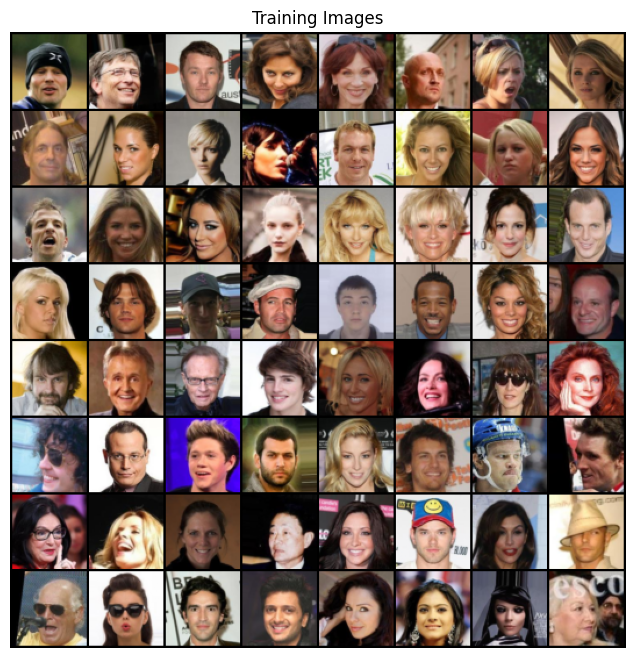

In [ ]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [ ]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [ ]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
# optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
# optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerD = optim.RMSprop(netD.parameters(),
                           lr=5e-5,          # try lower first
                           alpha=0.99,       # running‐avg coefficient
                           eps=1e-8)

optimizerG = optim.RMSprop(netG.parameters(),
                           lr=5e-5,
                           alpha=0.99,
                           eps=1e-8)

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/5][0/1583]	Loss_D: 1.5434	Loss_G: 17.2859	D(x): 0.7940	D(G(z)): 0.6395 / 0.0000
[0/5][50/1583]	Loss_D: 0.2194	Loss_G: 9.3940	D(x): 0.9646	D(G(z)): 0.1472 / 0.0001
[0/5][100/1583]	Loss_D: 0.0653	Loss_G: 7.1064	D(x): 0.9835	D(G(z)): 0.0452 / 0.0013
[0/5][150/1583]	Loss_D: 0.0375	Loss_G: 5.8543	D(x): 0.9751	D(G(z)): 0.0059 / 0.0036
[0/5][200/1583]	Loss_D: 0.0585	Loss_G: 8.2541	D(x): 0.9824	D(G(z)): 0.0293 / 0.0003
[0/5][250/1583]	Loss_D: 0.0218	Loss_G: 7.6148	D(x): 0.9958	D(G(z)): 0.0170 / 0.0006
[0/5][300/1583]	Loss_D: 0.0395	Loss_G: 5.9147	D(x): 0.9758	D(G(z)): 0.0022 / 0.0031
[0/5][350/1583]	Loss_D: 0.0291	Loss_G: 6.8249	D(x): 0.9895	D(G(z)): 0.0022 / 0.0013
[0/5][400/1583]	Loss_D: 0.0054	Loss_G: 7.3720	D(x): 0.9982	D(G(z)): 0.0035 / 0.0007
[0/5][450/1583]	Loss_D: 0.0043	Loss_G: 7.5084	D(x): 0.9983	D(G(z)): 0.0026 / 0.0007
[0/5][500/1583]	Loss_D: 0.0017	Loss_G: 7.7914	D(x): 0.9990	D(G(z)): 0.0007 / 0.0005
[0/5][550/1583]	Loss_D: 0.0049	Loss_G: 6.8077	D(x): 

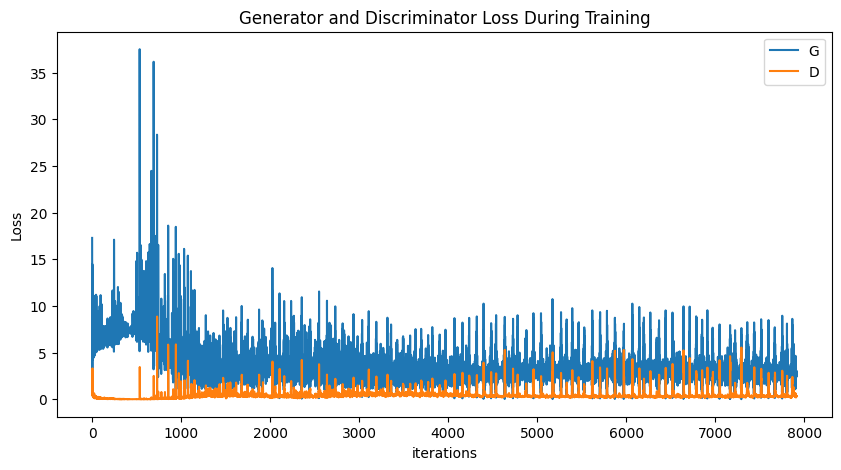

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

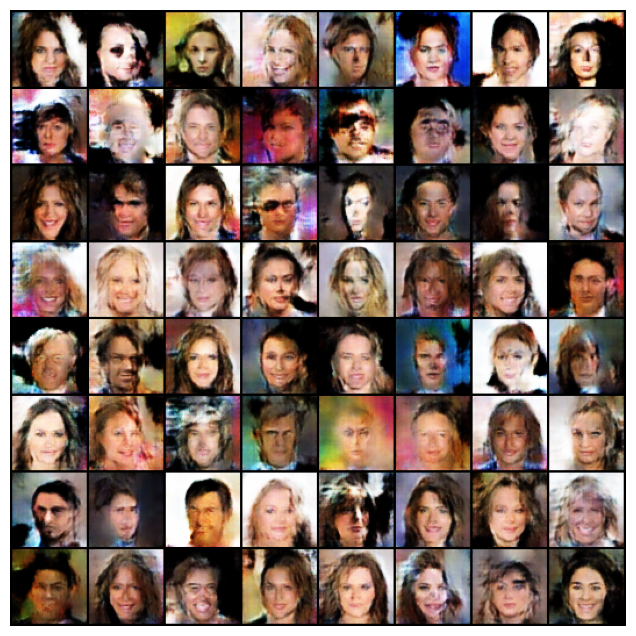

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

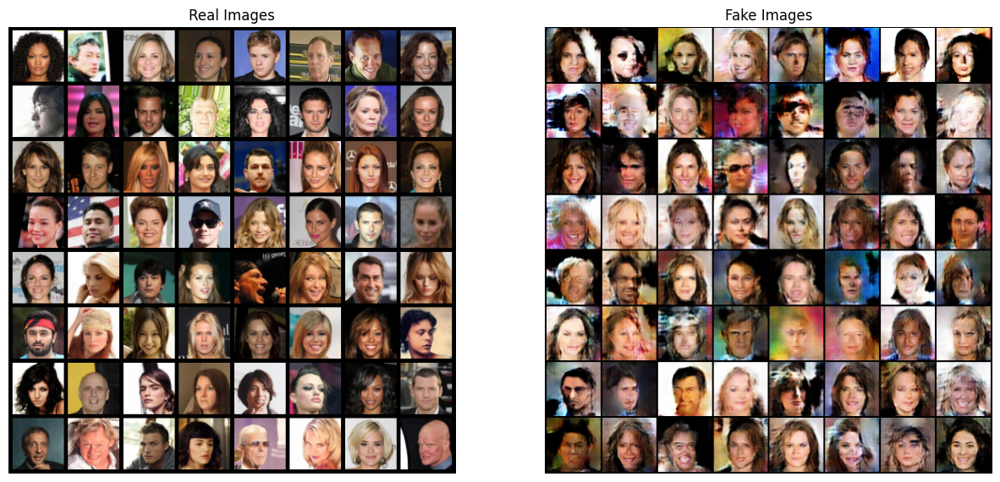

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [ ]:
# prompt: with the same parameter and datasets, implement a VAE model for this

# Define the VAE model
class VAE(nn.Module):
    def __init__(self, nc, ngf, ndf, nz):
        super(VAE, self).__init__()

        # Encoder
        self.encoder = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
        )

        self.fc_mu = nn.Linear(ndf * 8 * 4 * 4, nz)
        self.fc_logvar = nn.Linear(ndf * 8 * 4 * 4, nz)

        # Decoder
        self.decoder_input = nn.Linear(nz, ngf * 8 * 4 * 4)

        self.decoder = nn.Sequential(
            # input is (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def encode(self, x):
        h = self.encoder(x)
        h = h.view(h.size(0), -1)
        return self.fc_mu(h), self.fc_logvar(h)

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        h = self.decoder_input(z)
        h = h.view(h.size(0), ngf * 8, 4, 4)
        return self.decoder(h)

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar

# Create the VAE model
netVAE = VAE(nc, ngf, ndf, nz).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netVAE = nn.DataParallel(netVAE, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
netVAE.apply(weights_init)

# Print the model
print(netVAE)

# # VAE loss function
def vae_loss(recon_x, x, mu, logvar):
    # Reconstruction in ℝ, no range check
    MSE = nn.functional.mse_loss(recon_x, x, reduction='sum')
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return MSE + KLD


# Setup Adam optimizer for VAE
# optimizerVAE = optim.Adam(netVAE.parameters(), lr=lr, betas=(0.9, 0.999))
# optimizerVAE = torch.optim.AdamW(
#     netVAE.parameters(),
#     lr=2e-4,
#     betas=(0.9, 0.999),
#     weight_decay=1e-4
# )
optimizerVAE = torch.optim.RMSprop(
    netVAE.parameters(),
    lr=3e-4,          # good starting point
    alpha=0.99,       # running avg coefficient
    eps=1e-8
)




VAE(
  (encoder): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (fc_mu): Linear(in_features=8192, out_features=100, bias=True)
  (fc_logvar): Linear(in_features=8192, out_features=100, bias=Tru

In [ ]:
# Training Loop for VAE

print("Starting VAE Training Loop...")
# Lists to keep track of progress
vae_losses = []
vae_iters = 0
img_list_vae = [] # Initialize a new list for VAE images

# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        netVAE.zero_grad()

        real_cpu = data[0].to(device)
        recon_batch, mu, logvar = netVAE(real_cpu)
        loss = vae_loss(recon_batch, real_cpu, mu, logvar)

        loss.backward()
        optimizerVAE.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_VAE: %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     loss.item() / real_cpu.size(0)))

        # Save Losses for plotting later
        vae_losses.append(loss.item() / real_cpu.size(0))

        # Check how the generator is doing by saving G's output on fixed_noise
        if (vae_iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
             with torch.no_grad():
                fixed_noise_vae = torch.randn(64, nz, device=device)
                fake_vae = netVAE.decode(fixed_noise_vae).detach().cpu()
             img_list_vae.append(vutils.make_grid(fake_vae, padding=2, normalize=True))


        vae_iters += 1




Starting VAE Training Loop...
[0/5][0/1583]	Loss_VAE: 5121.5376
[0/5][50/1583]	Loss_VAE: 1792.7185
[0/5][100/1583]	Loss_VAE: 1575.6611
[0/5][150/1583]	Loss_VAE: 1273.5066
[0/5][200/1583]	Loss_VAE: 1164.0669
[0/5][250/1583]	Loss_VAE: 1152.3193
[0/5][300/1583]	Loss_VAE: 1098.9570
[0/5][350/1583]	Loss_VAE: 1031.4005
[0/5][400/1583]	Loss_VAE: 1067.3115
[0/5][450/1583]	Loss_VAE: 954.5976
[0/5][500/1583]	Loss_VAE: 983.8808
[0/5][550/1583]	Loss_VAE: 990.4249
[0/5][600/1583]	Loss_VAE: 939.4204
[0/5][650/1583]	Loss_VAE: 920.7505
[0/5][700/1583]	Loss_VAE: 926.0649
[0/5][750/1583]	Loss_VAE: 896.0899
[0/5][800/1583]	Loss_VAE: 880.0948
[0/5][850/1583]	Loss_VAE: 897.3560
[0/5][900/1583]	Loss_VAE: 863.0360
[0/5][950/1583]	Loss_VAE: 832.3315
[0/5][1000/1583]	Loss_VAE: 830.7365
[0/5][1050/1583]	Loss_VAE: 788.5303
[0/5][1100/1583]	Loss_VAE: 851.7593
[0/5][1150/1583]	Loss_VAE: 794.0441
[0/5][1200/1583]	Loss_VAE: 842.0137
[0/5][1250/1583]	Loss_VAE: 904.3214
[0/5][1300/1583]	Loss_VAE: 955.4437
[0/5][1350/1

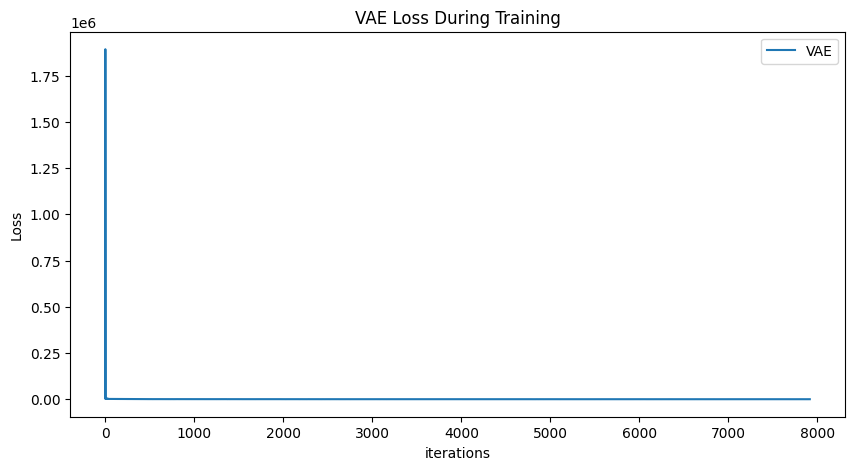

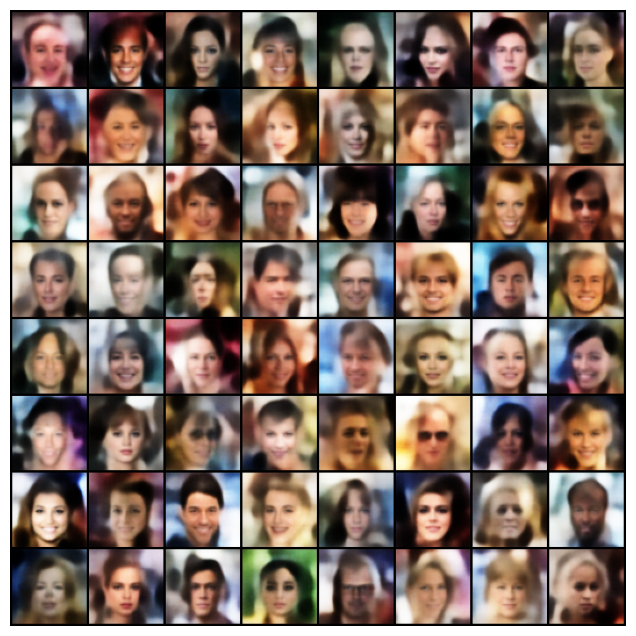

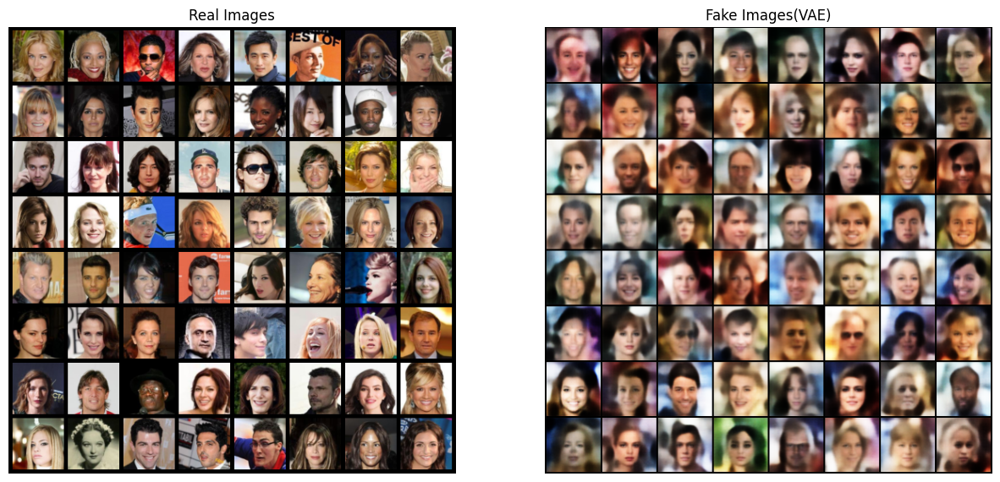

In [ ]:
plt.figure(figsize=(10,5))
plt.title("VAE Loss During Training")
plt.plot(vae_losses,label="VAE")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_vae] # Use the new list
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images(VAE)")
plt.imshow(np.transpose(img_list_vae[-1],(1,2,0))) # Use the new list
plt.show()

In [ ]:
import torch
import torch.nn.functional as F
from math import exp
from torchvision.models import inception_v3
from torchvision.transforms import Compose, Resize, CenterCrop, Normalize
import torch, torch.nn.functional as F

def inception_score(generator, nz, *,
                    n_samples=5000, batch_size=100, splits=10,
                    device='cuda',   # <-- normal PyTorch device
                    add_spatial=False):         # <-- ONLY True for DCGAN
    """
    generator : function(z) -> images in [-1,1], shape (B,3,64,64)
    nz        : latent dim
    add_spatial: set to True if the generator needs latent of shape
                 (B, nz, 1, 1)   (e.g. DCGAN); leave False for VAE.decode
    """
    import torch, torch.nn.functional as F
    from torchvision.models import inception_v3
    from torchvision.transforms import Compose, Resize, CenterCrop, Normalize

    # 1.  Inception-v3
    inc = inception_v3(weights="IMAGENET1K_V1").to(device).eval()
    for p in inc.parameters(): p.requires_grad_(False)

    # 2.  Resize-&-normalise transform (CPU → GPU later)
    tx = Compose([
        Resize(299, antialias=True),
        CenterCrop(299),
        lambda t: (t + 1) / 2,                 # [-1,1] → [0,1]
        Normalize([0.5]*3, [0.5]*3)            # [0,1]  → [-1,1]
    ])

    preds = []
    with torch.no_grad():
        for _ in range(0, n_samples, batch_size):
            z = torch.randn(batch_size, nz, device=device)
            if add_spatial:                    # ★ ONLY for DCGAN
                z = z.unsqueeze(-1).unsqueeze(-1)

            imgs = generator(z)                # (B,3,64,64)
            imgs = torch.stack([tx(im.cpu()) for im in imgs]).to(device)
            preds.append(F.softmax(inc(imgs), dim=1))

    preds   = torch.cat(preds, 0)              # (N,1000)
    split   = preds.size(0) // splits
    scores  = []
    for p in preds.split(split):
        py  = p.mean(0, keepdim=True)
        kl  = p * (p.log() - py.log())
        scores.append(torch.exp(kl.sum(1).mean()))

    scores = torch.stack(scores)               # (splits,)
    return scores.mean().item(), scores.std().item()


# ----- VAE --------------------------------------------------
is_mean, is_std = inception_score(
    generator   = netVAE.decode,   # takes (B, nz)
    nz          = nz,
    device      = device,
    add_spatial = False            # ← default, can omit
)
print(f"VAE IS  : {is_mean:.2f} ± {is_std:.2f}")

# ----- DCGAN -----------------------------------------------
# is_mean, is_std = inception_score(
#     generator   = netG,            # expects (B, nz, 1, 1)
#     nz          = nz,
#     device      = device,
#     add_spatial = True             # ← key difference
# )
# print(f"DCGAN IS: {is_mean:.2f} ± {is_std:.2f}")



VAE IS  : 2.02 ± 0.03
